#Netflix Movies and TV Shows EDA - PART2 (Python + R)

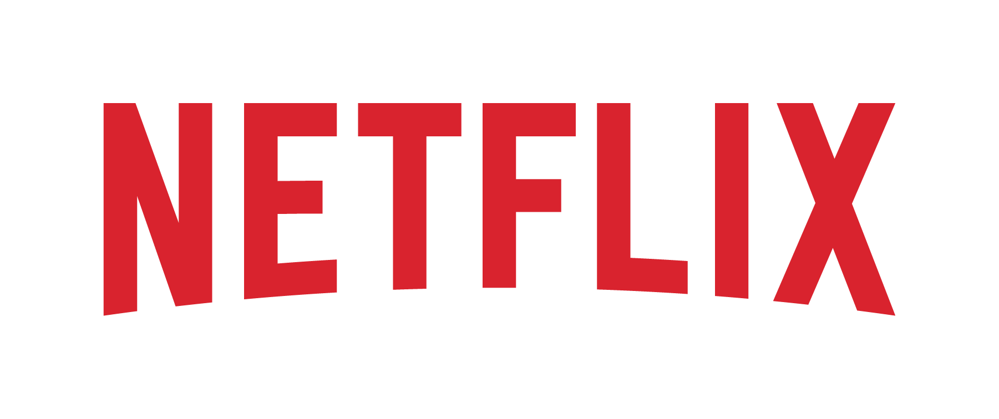

# SETTING

In [ ]:
#standard library
import os
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import datetime as dt
import missingno as msno

#library for visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly as py
import plotly.graph_objs as go
import plotly.offline as py
import plotly.graph_objects as go
from plotly.offline import iplot
from plotly.subplots import make_subplots

#ensure that the matplotlib plots are displayed in the notebook's output cell,
%matplotlib inline

#library for EDA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, AffinityPropagation

#Official google colaboratory method
#reference: https://stackoverflow.com/questions/54028965/how-to-display-plotly-outputs-in-google-collaboratory-notebooks
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
  init_notebook_mode(connected=False)

#initialize plotly for the notebook
py.offline.init_notebook_mode(connected = True)

#display all columns in dataframe.
pd.set_option("display.max_columns", None)

#setting the resolution of the figure
plt.rcParams['figure.dpi'] = 240

# STAGE 4 (Analyze)



###Loading dataset

In [ ]:
#loading dataset after cleaning
main_df = pd.read_csv("/content/drive/MyDrive/school_projects/DsDv/dataset/netflix_titles_cleaned.csv")
main_df.head(5)

,show_id,type,title,country,date_added,release_year,age_certification,duration,genres,description,principal_country,year_added,month_added,target_ages
0,s1,Movie,Dick Johnson Is Dead,United States,"September 25, 2021",2020,PG-13,90 min,Documentaries,"As her father nears the end of his life, filmm...",United States,2021,September,Teens
1,s2,TV Show,Blood & Water,South Africa,"September 24, 2021",2021,TV-MA,2 Seasons,"International TV Shows, TV Dramas, TV Mysteries","After crossing paths at a party, a Cape Town t...",South Africa,2021,September,Adults
2,s3,TV Show,Ganglands,United States,"September 24, 2021",2021,TV-MA,1 Season,"Crime TV Shows, International TV Shows, TV Act...",To protect his family from a powerful drug lor...,United States,2021,September,Adults
3,s4,TV Show,Jailbirds New Orleans,United States,"September 24, 2021",2021,TV-MA,1 Season,"Docuseries, Reality TV","Feuds, flirtations and toilet talk go down amo...",United States,2021,September,Adults
4,s5,TV Show,Kota Factory,India,"September 24, 2021",2021,TV-MA,2 Seasons,"International TV Shows, Romantic TV Shows, TV ...",In a city of coaching centers known to train I...,India,2021,September,Adults


In [ ]:
main_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8797 entries, 0 to 8796
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   show_id            8797 non-null   object
 1   type               8797 non-null   object
 2   title              8797 non-null   object
 3   country            8797 non-null   object
 4   date_added         8797 non-null   object
 5   release_year       8797 non-null   int64 
 6   age_certification  8797 non-null   object
 7   duration           8797 non-null   object
 8   genres             8797 non-null   object
 9   description        8797 non-null   object
 10  principal_country  8795 non-null   object
 11  year_added         8797 non-null   int64 
 12  month_added        8709 non-null   object
 13  target_ages        8791 non-null   object
dtypes: int64(2), object(12)
memory usage: 962.3+ KB


### Because this is the part 2 of the project, so you need to fix the datatype again

In [ ]:
#type should be a category
main_df['type'] = pd.Categorical(main_df['type'])

#target_ages is another category (4 classes)
main_df['target_ages'] = pd.Categorical(main_df['target_ages'], categories=['Kids', 'Older Kids', 'Teens', 'Adults'])

#year added should be integer so we can compare with `released_year`
main_df['year_added'] = pd.to_numeric(main_df['year_added'])

In [ ]:
main_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8797 entries, 0 to 8796
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype   
---  ------             --------------  -----   
 0   show_id            8797 non-null   object  
 1   type               8797 non-null   category
 2   title              8797 non-null   object  
 3   country            8797 non-null   object  
 4   date_added         8797 non-null   object  
 5   release_year       8797 non-null   int64   
 6   age_certification  8797 non-null   object  
 7   duration           8797 non-null   object  
 8   genres             8797 non-null   object  
 9   description        8797 non-null   object  
 10  principal_country  8795 non-null   object  
 11  year_added         8797 non-null   int64   
 12  month_added        8709 non-null   object  
 13  target_ages        8791 non-null   category
dtypes: category(2), int64(2), object(10)
memory usage: 842.3+ KB


# Number of Movies vs Number of TV Shows

In [ ]:
#count the number of Movies and number of TV Shows
count_types = main_df['type'].value_counts()

print(count_types)

Movie      6131
TV Show    2666
Name: type, dtype: int64


In [ ]:
netflix_types = ['Movie', 'TV Show']

#set a color
colors = ['#b20710', '#221f1f']
#ploting
fig_movie_tv = go.Figure(data=[go.Bar(x=netflix_types, y=[6131, 2666])])

#customize the layout (optional)
fig_movie_tv.update_traces(marker=dict(color=colors))
fig_movie_tv.update_layout(title="Number of Movies vs Number of TV Shows")

enable_plotly_in_cell()

#show a plot
fig_movie_tv.show()

###Clearly, the quantity of movies available on Netflix surpasses the number of TV shows.

#Distribution of Content Types(Percentage of Movies and TV Shows)

* Visualize the percentage of the Movies and TV Shows

In [ ]:
#determine the content types' % distribution.
x = main_df.groupby(['type'])['type'].count()
y = len(main_df)
r = ((x / y) * 100).round(2)

#create a DataFrame to store the percentage distribution
mf_ratio = pd.DataFrame(r)
mf_ratio.rename({'type': '%'}, axis=1, inplace=True)

#create a pie chart using Plotly
fig_type = px.pie(mf_ratio, names=mf_ratio.index, values='%',
             color_discrete_sequence=['#b20710', '#221f1f'],
             hole=0.3,
             labels={'%': 'Percentage'},
             title='Distribution of Content Types')

#customize the layout for a 3D effect
fig_type.update_traces(textinfo='percent+label', pull=[0.1, 0], marker=dict(line=dict(color='white', width=2)))
fig_type.update_layout(legend=dict(x=0.8, y=1))

#show the Plotly chart
enable_plotly_in_cell()
fig_type.show()

###Nearly 2/3rd of the content on netflix are movies while the rest are TV Show
### The pie chart representation indicates that roughly 70% of Netflix's content is comprised of movies, while the remaining 30% is dedicated to TV shows.

# Top 10 Countries Where Netflix is Popular

* Visualize Top 10 Countries Where Netflix is Popular

In [ ]:
#remove white spaces from 'country' column
main_df['country'] = main_df['country'].str.rstrip()

#counts
country_counts = main_df['country'].value_counts()

#select the top 10 countries
top_10_countries = country_counts.head(10)

#create a DataFrame for the top 10 countries
top_10_df = pd.DataFrame({'Country': top_10_countries.index, 'Number of Titles': top_10_countries.values})

colors = ['#b20710', '#9f060e', '#8c060d', '#79050b', '#670409', '#540308', '#410306', '#2e0204', '#1b0102', '#080001']  # Define custom colors for the bars

#colors_reversed = colors[::-1]
# Create a bar plot using Plotly
fig_top10 = px.bar(top_10_df, x='Country', y='Number of Titles', title='Top 10 Countries Where Netflix is Popular')

fig_top10.update_layout(xaxis_title='Country', yaxis_title='Number of Titles')

#add count values on top of each bar
#customize the layout (optional)
fig_top10.update_traces(marker=dict(color=colors))
fig_top10.update_traces(texttemplate='%{y}', textposition='outside')
enable_plotly_in_cell()
fig_top10.show()

### The bar graph representation shows that the United States stands as the foremost nation in terms of Netflix popularity.

#Numbers of Movies vs TV Shows in Top Countries

In [ ]:
# Filter data for the US, India, and UK
selected_countries = ['United States', 'India', 'United Kingdom']
filtered_data = main_df[main_df['country'].isin(selected_countries)]

# Filter data for movies and TV shows
filtered_movies = filtered_data[filtered_data['type'] == 'Movie']
filtered_tv_shows = filtered_data[filtered_data['type'] == 'TV Show']

# Count movies and TV shows for each country
movies_count = [filtered_movies[filtered_movies['country'] == country]['type'].count() for country in selected_countries]
tv_shows_count = [filtered_tv_shows[filtered_tv_shows['country'] == country]['type'].count() for country in selected_countries]

# Plotting the stacked bar chart
fig_movie_tv_stacked = go.Figure()

fig_movie_tv_stacked.add_trace(go.Bar(
    x=selected_countries,
    y=movies_count,
    name='Movies',
    marker_color='#b20710'
))

fig_movie_tv_stacked.add_trace(go.Bar(
    x=selected_countries,
    y=tv_shows_count,
    name='TV Shows',
    marker_color='#221f1f'
))

# Customize the layout
fig_movie_tv_stacked.update_layout(
    barmode='stack',
    title="Number of Movies vs Number of TV Shows for US, India, and UK"
)

enable_plotly_in_cell()
# Show the plot
fig_movie_tv_stacked.show()

#Top 10 Genres by Movie/TV Show Count

In [ ]:
#all the genres
unique_genres = main_df['genres'].unique()
#print(unique_genres) // print it if you want to see all the genres

In [ ]:
all_genres = set(main_df['genres'])
print(all_genres)

{'Action & Adventure, Dramas', 'TV Comedies, TV Sci-Fi & Fantasy', 'Music & Musicals', 'Dramas, International Movies', 'Documentaries, International Movies, Music & Musicals', 'Action & Adventure, Anime Features, International Movies', "Kids' TV, Korean TV Shows, TV Comedies", 'Classic Movies, Independent Movies, Thrillers', 'Comedies, Cult Movies, Horror Movies', 'Anime Series, TV Horror, TV Thrillers', "Kids' TV, Reality TV, TV Dramas", 'Comedies, Cult Movies, International Movies', 'Classic Movies, Dramas, Music & Musicals', 'Reality TV, TV Action & Adventure, TV Mysteries', 'Action & Adventure, Horror Movies', 'Romantic TV Shows, TV Dramas', 'TV Comedies, TV Dramas', 'Dramas, Horror Movies, Sci-Fi & Fantasy', 'British TV Shows, Docuseries', 'International TV Shows, Spanish-Language TV Shows, Stand-Up Comedy & Talk Shows', 'Comedies, Cult Movies, LGBTQ Movies', 'Comedies, Cult Movies, Sci-Fi & Fantasy', "Kids' TV, TV Comedies, TV Dramas", 'Dramas, Sci-Fi & Fantasy, Thrillers', "Clas

###Count the occurrences of each genre and Selected top 10 Genres

In [ ]:
#count the occurrences of each genre
genres_counts = main_df['genres'].value_counts()
top_10_genres = genres_counts.head(10)
top_10_genres

Dramas, International Movies                        362
Documentaries                                       359
Stand-Up Comedy                                     334
Comedies, Dramas, International Movies              274
Dramas, Independent Movies, International Movies    252
Kids' TV                                            219
Children & Family Movies                            215
Children & Family Movies, Comedies                  201
Documentaries, International Movies                 186
Dramas, International Movies, Romantic Movies       180
Name: genres, dtype: int64

###The Percentage Distribution for The Top 10 Genres

In [ ]:
# Calculate the count of each genre
genres_counts = main_df['genres'].value_counts()

# Select the top 10 genres
top_10_genres = genres_counts.head(10)

# Calculate the total count of genres
total_top10_genres_count = top_10_genres.sum()

# Calculate the percentage distribution for the top 10 genres
top10_percentage_distribution = (top_10_genres / total_top10_genres_count) * 100
top10_percentage_distribution = top10_percentage_distribution.round(2)

print("Percentage distribution of the top 10 genres:")
print(top10_percentage_distribution)

Percentage distribution of the top 10 genres:
Dramas, International Movies                        14.02
Documentaries                                       13.90
Stand-Up Comedy                                     12.94
Comedies, Dramas, International Movies              10.61
Dramas, Independent Movies, International Movies     9.76
Kids' TV                                             8.48
Children & Family Movies                             8.33
Children & Family Movies, Comedies                   7.78
Documentaries, International Movies                  7.20
Dramas, International Movies, Romantic Movies        6.97
Name: genres, dtype: float64


In [ ]:
# Create a DataFrame for the percentage distribution of top 10 genres
top10_genres_ratio = pd.DataFrame(top10_percentage_distribution)
top10_genres_ratio.rename({0: 'Percentage'}, axis=1, inplace=True)  # Rename the column to 'Percentage'

# Create a pie chart using Plotly
fig_top10_genres = px.pie(top10_genres_ratio, names = top10_genres_ratio.index, values='genres',  # Use 'Percentage' column for values
             color_discrete_sequence=['#b20710', '#9f060e', '#8c060d', '#79050b', '#670409', '#540308', '#410306', '#2e0204', '#1b0102', '#080001'],
             hole=0.3,
             labels={'Percentage': 'Percentage'},
             title='Distribution of Top 10 Genres')

# Customize the layout for better visualization
fig_top10_genres.update_traces(textinfo='percent+label', pull=[0.3, 0.2, 0.1, 0, 0, 0, 0, 0, 0, 0], marker=dict(line=dict(color='white', width=2)))
fig_top10_genres.update_layout(legend=dict(x=2, y=1))
height=800,  # Adjust the height of the plot
width=800,  # Adjust the width of the plot

# Show the Plotly chart
enable_plotly_in_cell()
fig_top10_genres.show()

###Select the top 3 genres:

In [ ]:
#Select the top 3 genres:
top_3_genres = genres_counts.head(3)
top_3_genres

Dramas, International Movies    362
Documentaries                   359
Stand-Up Comedy                 334
Name: genres, dtype: int64

###Calculate percentages for the top 3 genres globally:

In [ ]:
# Calculate the count of each genre
genres_counts = main_df['genres'].value_counts()

# Select the top 10 genres
top_3_genres = genres_counts.head(3)

# Calculate the total count of genres
total_top3_genres_count = top_3_genres.sum()

# Calculate the percentage distribution for the top 10 genres
top3_percentage_distribution = (top_3_genres / total_top3_genres_count) * 100
top3_percentage_distribution = top3_percentage_distribution.round(2)

print("Percentage distribution of the top 3 genres:")
print(top3_percentage_distribution)

Percentage distribution of the top 3 genres:
Dramas, International Movies    34.31
Documentaries                   34.03
Stand-Up Comedy                 31.66
Name: genres, dtype: float64


In [ ]:
# Create a DataFrame for the percentage distribution of top 10 genres
top3_genres_ratio = pd.DataFrame(top3_percentage_distribution)
top3_genres_ratio.rename({0: 'Percentage'}, axis=1, inplace=True)  # Rename the column to 'Percentage'

# Create a pie chart using Plotly
fig_top3_genres = px.pie(top3_genres_ratio, names = top3_genres_ratio.index, values='genres',  # Use 'Percentage' column for values
             color_discrete_sequence=['#b20710', '#9f060e', '#8c060d'],
             hole=0.3,
             labels={'Percentage': 'Percentage'},
             title='Distribution of Top 10 Genres')

# Customize the layout for better visualization
fig_top3_genres.update_traces(textinfo='percent+label', pull=[0, 0, 0], marker=dict(line=dict(color='white', width=2)))
fig_top3_genres.update_layout(legend=dict(x=2, y=1))
height=600,  # Adjust the height of the plot
width=100,  # Adjust the width of the plot

# Show the Plotly chart
enable_plotly_in_cell()
fig_top3_genres.show()

#Top 3 Genres of Top 3 Country

In [ ]:
# Filter data for the US, India, and UK
selected_countries = ['United States', 'India', 'United Kingdom']
filtered_data = main_df[main_df['country'].isin(selected_countries)]

# Filter data for top 3 genres
filtered_genres_top1 = filtered_data[filtered_data['genres'] == 'Dramas, International Movies']
filtered_genres_top2 = filtered_data[filtered_data['genres'] == 'Documentaries']
filtered_genres_top3 = filtered_data[filtered_data['genres'] == 'Stand-Up Comedy']

# Count genres for each country
top1_genres_count = [filtered_genres_top1[filtered_genres_top1['country'] == country]['genres'].count() for country in selected_countries]
top2_genres_count = [filtered_genres_top2[filtered_genres_top2['country'] == country]['genres'].count() for country in selected_countries]
top3_genres_count = [filtered_genres_top3[filtered_genres_top3['country'] == country]['genres'].count() for country in selected_countries]

In [ ]:
# Create a multiple bar chart
fig_genres_bars = go.Figure()

# Add bars for each genre in each country
fig_genres_bars.add_trace(go.Bar(
    x=selected_countries,
    y=top1_genres_count,
    name='Dramas, International Movies',
    marker_color='#c50812'
))

fig_genres_bars.add_trace(go.Bar(
    x=selected_countries,
    y=top2_genres_count,
    name='Documentaries',
    marker_color='#540308'
))

fig_genres_bars.add_trace(go.Bar(
    x=selected_countries,
    y=top3_genres_count,
    name='Stand-Up Comedy',
    marker_color='#8c060d'
))

# Customize the layout
fig_genres_bars.update_layout(
    barmode='group',
    title="Number of Genres for US, India, and UK",
    xaxis=dict(title='Countries'),
    yaxis=dict(title='Genre Counts')
)

enable_plotly_in_cell()
# Show the plot
fig_genres_bars.show()

###Setting a little bit

In [ ]:
data_sub = main_df.groupby('type')['genres'].value_counts().unstack().fillna(0).loc[['TV Show','Movie']].cumsum(axis=0).T

In [ ]:
data_sub2 = data_sub

data_sub2['Value'] = data_sub2['Movie'] + data_sub2['TV Show']
data_sub2 = data_sub2.reset_index()

df_polar = data_sub2.sort_values(by='genres',ascending=False)

* Visualize top 10 Categories by Movie/TV Show Count

In [ ]:
# Count the occurrences of each genre
genres_counts = main_df['genres'].value_counts()

# Select the top 10 genres
top_10_genres = genres_counts.head(10)

# Create a DataFrame for the top 10 genres
top_10_genres_df = pd.DataFrame({'Category': top_10_genres.index, 'Number of Movies/TV Shows': top_10_genres.values})

# Set a color
colors = ['#b20710', '#9f060e', '#8c060d', '#79050b', '#670409', '#540308', '#410306', '#2e0204', '#1b0102', '#080001']

# Create a list of labels from the 'genres' column in df_polar
labels = df_polar['genres'].tolist()

# Create a polar chart
fig_genres_polar = go.Figure()

# Add bar traces to the polar chart
fig_genres_polar.add_trace(go.Barpolar(
    r = top_10_genres_df['Number of Movies/TV Shows'],
    theta = top_10_genres_df['Category'],
    marker_color = colors,
    hoverinfo = 'r+theta',
    text = labels,  #modified labels here
))

# Customize the layout (optional)
fig_genres_polar.update_layout(
    polar=dict(
        radialaxis=dict(visible = False),
        bgcolor='rgba(0,0,0,0)',  # Set background color to fully transparent

    ),
    title = 'Top 10 Genres by Movie/TV Show Count',
)

# Show the plot
enable_plotly_in_cell()
fig_genres_polar.show()

### The bar graph illustrates the top 10 movie and TV show categories ranked by their frequency. "International Movies" holds the highest position, with "Dramas" coming in second place.

#KeyWord

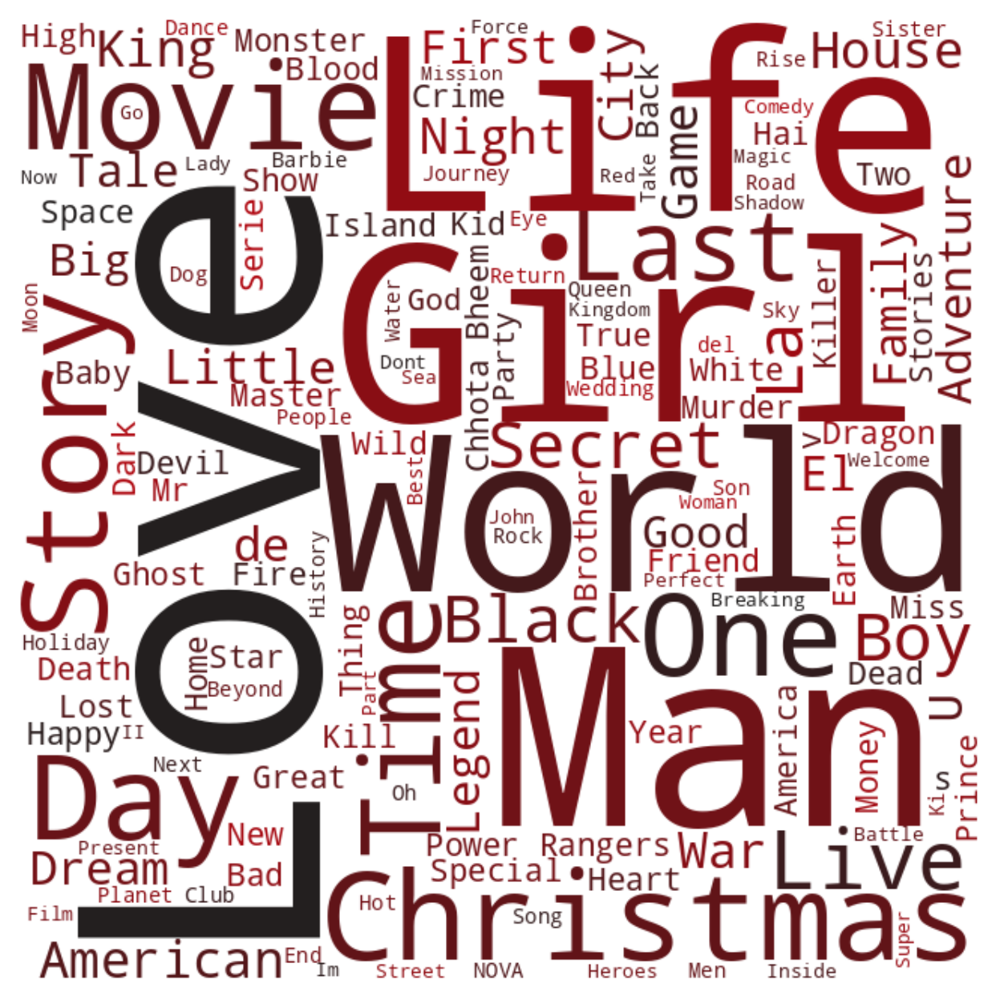

In [ ]:
from wordcloud import WordCloud
import random
from PIL import Image
import matplotlib

# Custom colour map based on Netflix palette
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ['#221f1f', '#b20710'])

text = str(list(main_df['title'])).replace(',', '').replace('[', '').replace("'", '').replace(']', '').replace('.', '')

mask = np.array(Image.open('/content/drive/MyDrive/school_projects/DsDv/Demo/Netflix-new-icon.png'))

wordcloud = WordCloud(background_color = 'white', width = 500,  height = 200,colormap=cmap, max_words = 150, mask = mask).generate(text)

plt.figure( figsize=(5,5))
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')